# BCT graph metrics <a id='bct-graph-metrics'></a>

In [ ]:
import pandas as pd
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib  # load the beta maps in python
from nilearn import plotting  # plot nifti images
from bct import nbs
from scipy.io import savemat
from mne.viz import plot_connectivity_circle

In [ ]:
data_dir = '/Volumes/psybrain/ADM/derivatives'
results_dir = '/Volumes/schnyer/Megan/adm_mem-fc/analysis/stats/'
nibs_dir='/Volumes/psybrain/ADM/derivatives/nibs/nibetaseries'

tasks = ['MemMatch1', 'MemMatch2', 'MemMatch3']
trial_types = ['cue', 'match', 'mismatch']

atlas_file='/Volumes/psybrain/ADM/derivatives/nibs/power264-master/power264MNI.nii.gz'
atlas_lut='/Volumes/psybrain/ADM/derivatives/nibs/power264_labels.tsv'

In [ ]:
subjects = np.loadtxt(data_dir + '/nibs/subjects.txt', dtype=str)
subjects

In [ ]:
atlas = pd.read_csv(atlas_lut, sep='\t').set_index('index')

atlas.regions.unique()

In [ ]:
atlas = pd.read_csv(atlas_lut, sep='\t').set_index('index')

dmn = atlas.loc[atlas['regions'].str.contains('Default')].index.tolist()
fpn = atlas.loc[atlas['regions'].str.contains('Fronto-parietal')].index.tolist()
dmn_fpn = np.concatenate((dmn, fpn))

In [ ]:
from nilearn import datasets

power = datasets.fetch_coords_power_2011()
coords = np.vstack((power.rois['x'], power.rois['y'], power.rois['z'])).T

In [ ]:
x = np.load('/Volumes/psybrain/ADM/derivatives/nibs/memmatch_fc.npy', allow_pickle=True).flat[0]
fc_subs = np.loadtxt('/Volumes/psybrain/ADM/derivatives/nibs/fcsubs.txt', dtype=str)

In [293]:
subjects

array(['30004', '30008', '30009', '30015', '30019', '30020', '30023',
       '30040', '30057', '30064', '30066', '30069', '30074', '30085',
       '30088', '30090', '30091', '30095', '30096', '30105', '30116',
       '30118', '30119', '30128', '30181', '30217', '30227', '30236',
       '30242', '30255', '30274', '30283', '30295', '30330', '30346',
       '30376', '30395', '30400', '30403', '30412', '30426', '30432',
       '30466', '30469', '30476', '30478', '30568', '30570', '30581',
       '30584', '30588', '40160', '40170', '40175', '40288', '40351',
       '40490', '40512', '40519', '40520', '40524', '40547', '40564',
       '40615', '40619', '40624', '40638', '40649', '40650', '40656',
       '40658', '40664', '40665', '40668', '40672', '40685', '40694',
       '40720', '40738', '40743', '40750', '40773', '40778', '40796',
       '40803', '40855', '40861', '40930', '40961', '40968'], dtype='<U5')

In [475]:
from bct import visualization

visualization.reorderMAT(nbs_edge_z[:,:,0], H=5000, cost='line')

(array([[ 0.        ,  0.12128273,  0.12128273,  0.19842009,  0.05218095,
          0.02865889,  0.12128273,  0.19842009,  0.        , -0.19716169,
         -0.19716169, -0.10733827,  0.16009695,  0.        ],
        [ 0.57895376,  0.        ,  0.57895376,  0.0635338 ,  0.34021789,
          0.04968686,  0.57895376,  0.0635338 ,  0.16009695,  0.17945112,
          0.17945112,  0.05033267,  0.        ,  0.16009695],
        [ 0.16506049,  0.16506049,  0.        ,  0.19811561,  0.37756139,
          0.53139219,  0.16506049,  0.19811561, -0.10733827,  0.20148167,
          0.20148167,  0.        ,  0.05033267, -0.10733827],
        [ 0.21300719,  0.21300719,  0.21300719,  0.        ,  0.35655462,
          0.47565916,  0.21300719,  0.36651432, -0.19716169,  0.        ,
          0.        ,  0.20148167,  0.17945112, -0.19716169],
        [ 0.21300719,  0.21300719,  0.21300719,  0.36651432,  0.        ,
          0.47565916,  0.21300719,  0.36651432, -0.19716169,  0.        ,
          0.

{'Default mode': 0, 'Fronto-parietal Task Control': 1}


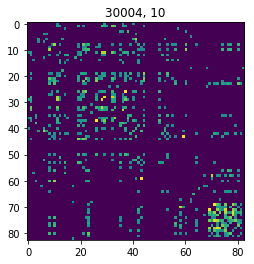

/usr/local/lib/python3.7/site-packages/bct/algorithms/centrality.py:738: RuntimeWarning: invalid value encountered in true_divide
  P = np.ones((n,)) - Kc2 / np.square(Ko)


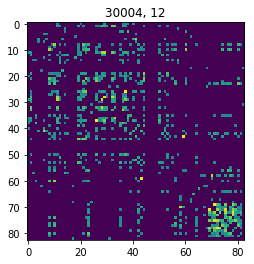

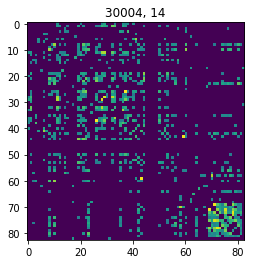

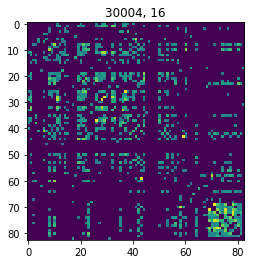

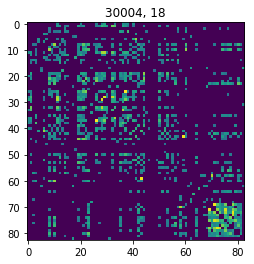

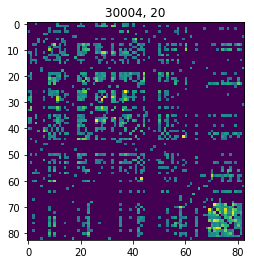

...

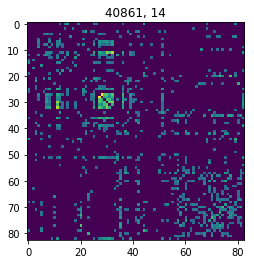

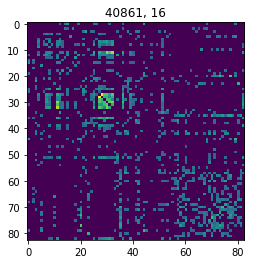

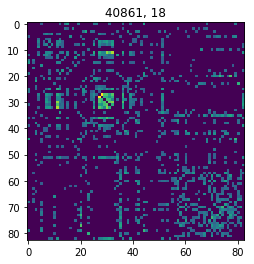

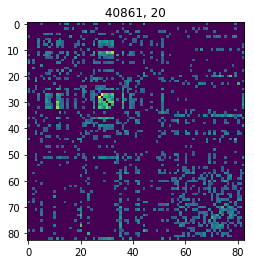

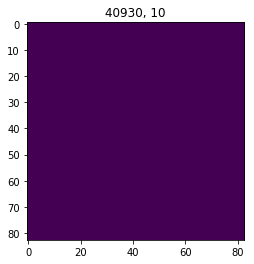

/usr/local/lib/python3.7/site-packages/bct/algorithms/modularity.py:1490: RuntimeWarning: invalid value encountered in true_divide
  B = A - gamma * np.outer(k, k) / m  # initial modularity matrix


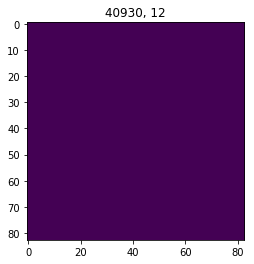

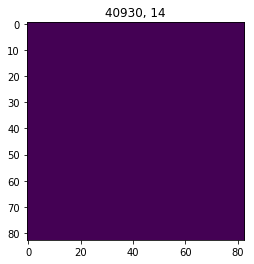

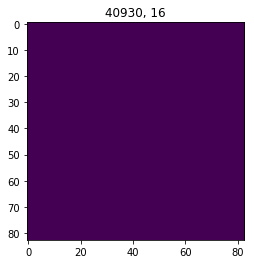

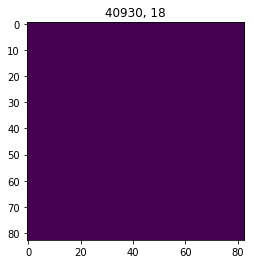

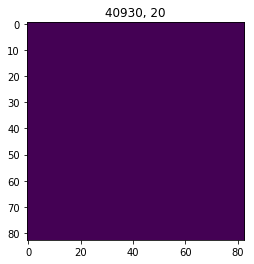

{'Cingulo-opercular Task Control': 0, 'Uncertain': 1, 'Fronto-parietal Task Control': 2, 'Auditory': 3, 'Default mode': 4, 'Visual': 5, 'Sensory/somatomotor Hand': 6, 'Cerebellar': 7, 'Memory retrieval?': 8, 'Ventral attention': 9, 'Salience': 10, 'Dorsal attention': 11, 'Sensory/somatomotor Mouth': 12, 'Subcortical': 13}


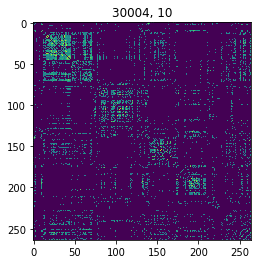

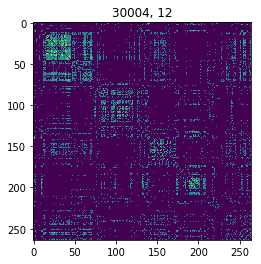

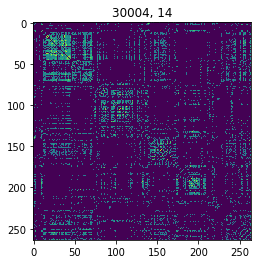

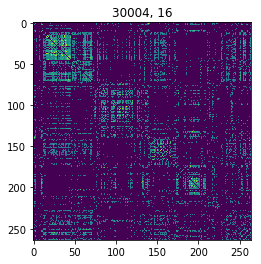

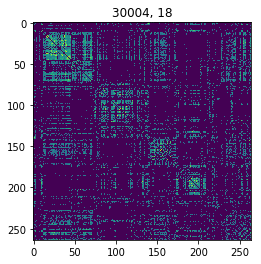

...

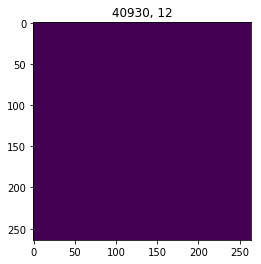

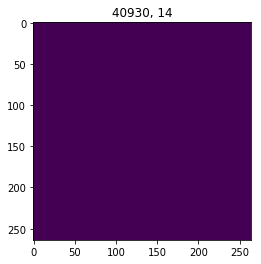

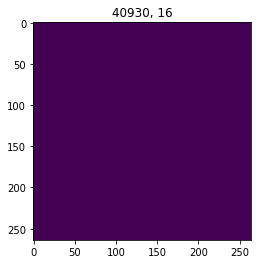

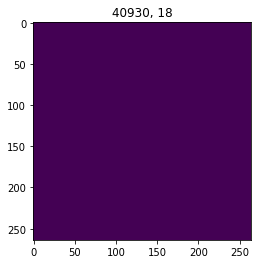

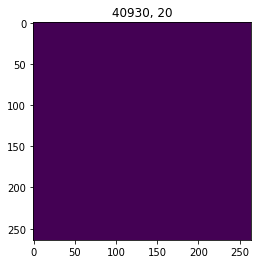

         mod_dmn_fpn_10  mod_dmn_fpn_12  mod_dmn_fpn_14  mod_dmn_fpn_16  \
subject                                                                   
30004          0.260968        0.251841        0.238911        0.231706   
30008          0.147741        0.140433        0.143314        0.140903   
30009          0.241790        0.246238        0.221749        0.217246   
30015          0.200473        0.191177        0.171439        0.167738   
30019          0.144170        0.129389        0.127038        0.121707   
30020          0.102649        0.096728        0.100399        0.093313   
30023          0.110217        0.098334        0.100076        0.093761   
30040          0.091225        0.097394        0.093996        0.091560   
30057          0.174341        0.166170        0.164828        0.155836   
30064          0.123293        0.109342        0.103771        0.098443   
30066          0.130606        0.125359        0.115402        0.110361   
30069          0.188923  

In [17]:
from bct import modularity
from bct import centrality
from bct import other
from bct import visualization

m_colnames = ['subject']
pc_colnames = ['subject']
thresholds = np.arange(10, 22, 2)


# thresholds = 'nbs'
# for thr in thresholds: m_colnames.append('mod_%s' % thr)
# for thr in thresholds: pc_colnames.append('pc_%s' % thr)
#wb = np.array(atlas.regions.index)

mod = pd.DataFrame()
pc = pd.DataFrame()
pc_array = {}

# m = nbs_edge_z
regions = ['dmn_fpn', 'wb']
pc_array = {}
m0 = x['cue']

for region in regions:
    
    if region == 'wb':
        m = m0.copy()
        d = {ni: indi for indi, ni in enumerate(set(atlas.regions))}
        print(d)
        communities = [d[ni] for ni in atlas.regions]
        
    else: 
        m = m0[eval(region)][:,eval(region),:]
        d = {ni: indi for indi, ni in enumerate(set(atlas.regions[eval(region)]))}
        print(d)
        communities = [d[ni] for ni in atlas.regions[eval(region)]]

    for subject, idx in zip(sorted(subjects), range(0, m.shape[2])): #     print(x['cue'][dmn_fpn][:,dmn_fpn,idx].shape)
        
        pc_array[subject] = {}
        #print(subject, idx)
        
        for threshold in thresholds:
            pc_array[subject][threshold] = {} 
            pc_array[subject]['mean'] = {} 
            
            g = other.threshold_proportional(m[:,:,idx], p=float(threshold)*.01, copy=True) #     g = visualization.reorderMAT(m[:,:,idx], H=5000, cost='line')[0]
            plt.imshow(g)
            plt.title(subject + ', ' + str(threshold))
            plt.show()
            
            mod = mod.append({'subject': subject, 'mod_%s_%s' % (region, threshold) : modularity.modularity_und(g, gamma=1, kci=communities)[1]}, ignore_index=True)

            if region == 'wb':
                pc_array[subject][threshold] = centrality.participation_coef(g, ci=communities, degree='undirected')
                
            if region == 'dmn_fpn':
                pc = pc.append({'subject': subject, 'pc_%s_%s' % (region, threshold) : centrality.participation_coef(g, ci=communities, degree='undirected').mean()}, ignore_index=True)

mod = mod.groupby(['subject']).sum()
pc = pc.groupby(['subject']).sum()

print(mod)
print(pc)

pc.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient.csv')
mod.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/modularity.csv')
np.save('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient_nodewise.npy', pc_array)

In [18]:
for subject in subjects[:-2]:
    pc_array[subject]['mean'] = []
    pc_array[subject]['mean'] = (pc_array[subject][10] + pc_array[subject][12] + pc_array[subject][14] + pc_array[subject][16] + pc_array[subject][18] + pc_array[subject][20])/6
    
np.save('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient_nodewise.npy', pc_array)

In [19]:
pc0 = pc.copy().reset_index()
pc0['pc_dmn_fpn_mean'] = pc0.mean(axis=1)

for subject in subjects[:-2]:
    rowIndex = pc0.index[pc0['subject'] == subject].to_list()
    pc0.loc[rowIndex, 'pc_dmn_mean'] = pc_array[subject]['mean'][dmn].mean()
    pc0.loc[rowIndex, 'pc_fpn_mean'] = pc_array[subject]['mean'][fpn].mean()

pc0 = pc0.set_index(['subject'])
pc0.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient.csv')
pc0

,pc_dmn_fpn_10,pc_dmn_fpn_12,pc_dmn_fpn_14,pc_dmn_fpn_16,pc_dmn_fpn_18,pc_dmn_fpn_20,pc_dmn_fpn_mean,pc_dmn_mean,pc_fpn_mean
subject,,,,,,,,,
30004,0.133083,0.150129,0.175267,0.189694,0.205587,0.218853,0.178769,0.585333,0.755358
30008,0.164194,0.179114,0.194050,0.203449,0.206955,0.218107,0.194311,0.586016,0.720762
30009,0.149404,0.170291,0.195783,0.203531,0.211377,0.222053,0.192073,0.482981,0.814453
30015,0.179652,0.215331,0.236555,0.252904,0.261610,0.277564,0.237269,0.651844,0.738657
30019,0.256892,0.290491,0.304593,0.312835,0.318376,0.331827,0.302502,0.715599,0.830522
30020,0.183445,0.198443,0.212673,0.219212,0.234516,0.238569,0.214476,0.690589,0.742340
30023,0.198789,0.227489,0.246323,0.251347,0.259999,0.278324,0.243712,0.608987,0.779721
30040,0.256539,0.280670,0.294189,0.314133,0.324340,0.327024,0.299483,0.685136,0.810084
30057,0.221792,0.253445,0.256582,0.274776,0.287274,0.293760,0.264605,0.610554,0.768614


In [560]:
mod[0:5]

,mod_10,mod_12,mod_14,mod_16,mod_18,mod_20
subject,,,,,,
30004,0.125659,0.130191,0.119558,0.111548,0.103587,0.102346
30008,0.188766,0.175560,0.163659,0.153286,0.145088,0.139573
30009,0.029908,0.032608,0.034110,0.038122,0.044705,0.044904
30015,0.104143,0.098877,0.092724,0.085591,0.078520,0.082808
30019,0.263958,0.252200,0.244926,0.239032,0.232553,0.219230


In [561]:
pd.DataFrame(mod.mean(axis=1))[0:5]

,0
subject,
30004,0.115482
30008,0.160989
30009,0.037393
30015,0.090444
30019,0.241983


In [562]:
pc[0:5]

,pc_10,pc_12,pc_14,pc_16,pc_18,pc_20
subject,,,,,,
30004,0.262939,0.285609,0.291172,0.298336,0.308285,0.318926
30008,0.222224,0.228443,0.249932,0.269266,0.283944,0.297537
30009,0.120514,0.141760,0.149292,0.179254,0.186274,0.203321
30015,0.254614,0.276558,0.302966,0.311653,0.325893,0.325014
30019,0.175193,0.185883,0.198617,0.214391,0.227517,0.245714


In [ ]:
# BCT graph metrics <a id='bct-graph-metrics'></a>

subjects

from bct import visualization

visualization.reorderMAT(nbs_edge_z[:,:,0], H=5000, cost='line')

from bct import modularity
from bct import centrality
from bct import other
from bct import visualization

m_colnames = ['subject']
pc_colnames = ['subject']
thresholds = np.arange(10, 22, 2)


# thresholds = 'nbs'
# for thr in thresholds: m_colnames.append('mod_%s' % thr)
# for thr in thresholds: pc_colnames.append('pc_%s' % thr)
#wb = np.array(atlas.regions.index)

mod = pd.DataFrame()
pc = pd.DataFrame()
pc_array = {}

# m = nbs_edge_z
regions = ['dmn_fpn', 'wb']
pc_array = {}
m0 = x['cue']

for region in regions:
    
    if region == 'wb':
        m = m0.copy()
        d = {ni: indi for indi, ni in enumerate(set(atlas.regions))}
        print(d)
        communities = [d[ni] for ni in atlas.regions]
        
    else: 
        m = m0[eval(region)][:,eval(region),:]
        d = {ni: indi for indi, ni in enumerate(set(atlas.regions[eval(region)]))}
        print(d)
        communities = [d[ni] for ni in atlas.regions[eval(region)]]

    for subject, idx in zip(sorted(subjects), range(0, m.shape[2])): #     print(x['cue'][dmn_fpn][:,dmn_fpn,idx].shape)
        
        pc_array[subject] = {}
        #print(subject, idx)
        
        for threshold in thresholds:
            pc_array[subject][threshold] = {} 
            pc_array[subject]['mean'] = {} 
            
            g = other.threshold_proportional(m[:,:,idx], p=float(threshold)*.01, copy=True) #     g = visualization.reorderMAT(m[:,:,idx], H=5000, cost='line')[0]
            plt.imshow(g)
            plt.title(subject + ', ' + str(threshold))
            plt.show()
            
            mod = mod.append({'subject': subject, 'mod_%s_%s' % (region, threshold) : modularity.modularity_und(g, gamma=1, kci=communities)[1]}, ignore_index=True)

            if region == 'wb':
                pc_array[subject][threshold] = centrality.participation_coef(g, ci=communities, degree='undirected')
                
            if region == 'dmn_fpn':
                pc = pc.append({'subject': subject, 'pc_%s_%s' % (region, threshold) : centrality.participation_coef(g, ci=communities, degree='undirected').mean()}, ignore_index=True)

mod = mod.groupby(['subject']).sum()
pc = pc.groupby(['subject']).sum()

print(mod)
print(pc)

pc.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient.csv')
mod.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/modularity.csv')
np.save('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient_nodewise.npy', pc_array)

for subject in subjects[:-2]:
    pc_array[subject]['mean'] = []
    pc_array[subject]['mean'] = (pc_array[subject][10] + pc_array[subject][12] + pc_array[subject][14] + pc_array[subject][16] + pc_array[subject][18] + pc_array[subject][20])/6
    
np.save('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient_nodewise.npy', pc_array)

pc0 = pc.copy().reset_index()
pc0['pc_dmn_fpn_mean'] = pc0.mean(axis=1)

for subject in subjects[:-2]:
    rowIndex = pc0.index[pc0['subject'] == subject].to_list()
    pc0.loc[rowIndex, 'pc_dmn_mean'] = pc_array[subject]['mean'][dmn].mean()
    pc0.loc[rowIndex, 'pc_fpn_mean'] = pc_array[subject]['mean'][fpn].mean()

pc0 = pc0.set_index(['subject'])
pc0.to_csv('/Volumes/psybrain/ADM/derivatives/nibs/results/participation_coefficient.csv')
pc0

mod[0:5]

pd.DataFrame(mod.mean(axis=1))[0:5]

pc[0:5]